# EPA Fuel Economy Data for 1984 - 2017

### From Kaggle (copied here for reference): 

"The purpose of EPA’s fuel economy estimates is to provide a reliable basis for comparing vehicles. Most vehicles in the database (other than plug-in hybrids) have three fuel economy estimates: a “city” estimate that represents urban driving, in which a vehicle is started in the morning (after being parked all night) and driven in stop-and-go traffic; a “highway” estimate that represents a mixture of rural and interstate highway driving in a warmed-up vehicle, typical of longer trips in free-flowing traffic; and a “combined” estimate that represents a combination of city driving (55%) and highway driving (45%). Estimates for all vehicles are based on laboratory testing under standardized conditions to allow for fair comparisons.

The database provides annual fuel cost estimates, rounded to the nearest 50 dollars, for each vehicle. The estimates are based on the assumptions that you travel 15,000 miles per year (55 pct under city driving conditions and 45 pct under highway conditions) and that fuel costs 2.33/gallon for regular unleaded gasoline, 2.58/gallon for mid-grade unleaded gasoline, and 2.82/gallon for premium.

EPA’s fuel economy values are good estimates of the fuel economy a typical driver will achieve under average driving conditions and provide a good basis to compare one vehicle to another. However, your fuel economy may be slightly higher or lower than EPA’s estimates. Fuel economy varies, sometimes significantly, based on driving conditions, driving style, and other factors."

#####  Will focus on the Combined City & Highway estimates for purposes of this analysis

In [529]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.pipeline import make_pipeline
import category_encoders as ce
import plotly.express as px
import plotly.offline as off
pd.options.plotting.backend = "plotly"
import matplotlib.pyplot as plt
from pdpbox import pdp, info_plots
from sklearn.ensemble import GradientBoostingRegressor

In [530]:
df = pd.read_csv("/Users/mcs275/dat-class-repo/Homework/Unit4/database.csv")

### Data Exploration and Visualization

In [531]:
df.head()
## because focus is on Combined estimates, will likely remove the City only and Highway only estimates for all relevant variables

,Vehicle ID,Year,Make,Model,Class,Drive,Transmission,Transmission Descriptor,Engine Index,Engine Descriptor,Engine Cylinders,Engine Displacement,Turbocharger,Supercharger,Fuel Type,Fuel Type 1,Fuel Type 2,City MPG (FT1),Unrounded City MPG (FT1),City MPG (FT2),Unrounded City MPG (FT2),City Gasoline Consumption (CD),City Electricity Consumption,City Utility Factor,Highway MPG (FT1),Unrounded Highway MPG (FT1),Highway MPG (FT2),Unrounded Highway MPG (FT2),Highway Gasoline Consumption (CD),Highway Electricity Consumption,Highway Utility Factor,Unadjusted City MPG (FT1),Unadjusted Highway MPG (FT1),Unadjusted City MPG (FT2),Unadjusted Highway MPG (FT2),Combined MPG (FT1),Unrounded Combined MPG (FT1),Combined MPG (FT2),Unrounded Combined MPG (FT2),Combined Electricity Consumption,Combined Gasoline Consumption (CD),Combined Utility Factor,Annual Fuel Cost (FT1),Annual Fuel Cost (FT2),Gas Guzzler Tax,Save or Spend (5 Year),Annual Consumption in Barrels (FT1),Annual Consumption in Barrels (FT2),Tailpipe CO2 (FT1),Tailpipe CO2 in Grams/Mile (FT1),Tailpipe CO2 (FT2),Tailpipe CO2 in Grams/Mile (FT2),Fuel Economy Score,GHG Score,GHG Score (Alt Fuel),My MPG Data,2D Passenger Volume,2D Luggage Volume,4D Passenger Volume,4D Luggage Volume,Hatchback Passenger Volume,Hatchback Luggage Volume,Start Stop Technology,Alternative Fuel/Technology,Electric Motor,Manufacturer Code,Gasoline/Electricity Blended (CD),Vehicle Charger,Alternate Charger,Hours to Charge (120V),Hours to Charge (240V),Hours to Charge (AC 240V),Composite City MPG,Composite Highway MPG,Composite Combined MPG,Range (FT1),City Range (FT1),Highway Range (FT1),Range (FT2),City Range (FT2),Highway Range (FT2)
0,26587,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,NaN,Manual 5-Speed,NaN,9001,(FFS),6.0,2.5,NaN,NaN,Regular,Regular Gasoline,NaN,17,0.0,0,0.0,0.0,0.0,0.0,24,0.0,0,0.0,0.0,0.0,0.0,21.0,34.0,0.0,0.0,20,0.0,0,0.0,0.0,0.0,0.0,1750,0,NaN,-2000,16.480500,0.0,-1,444.350000,-1,0.0,-1,-1,-1,N,74,7,0,0,0,0,NaN,NaN,NaN,NaN,False,NaN,NaN,0,0.0,0.0,0,0,0,0,0.0,0.0,NaN,0.0,0.0
1,27705,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,NaN,Manual 5-Speed,NaN,9005,(FFS) CA model,6.0,2.5,NaN,NaN,Regular,Regular Gasoline,NaN,17,0.0,0,0.0,0.0,0.0,0.0,24,0.0,0,0.0,0.0,0.0,0.0,21.0,34.0,0.0,0.0,20,0.0,0,0.0,0.0,0.0,0.0,1750,0,NaN,-2000,16.480500,0.0,-1,444.350000,-1,0.0,-1,-1,-1,N,74,7,0,0,0,0,NaN,NaN,NaN,NaN,False,NaN,NaN,0,0.0,0.0,0,0,0,0,0.0,0.0,NaN,0.0,0.0
2,26561,1984,Alfa Romeo,Spider Veloce 2000,Two Seaters,NaN,Manual 5-Speed,NaN,9002,(FFS),4.0,2.0,NaN,NaN,Regular,Regular Gasoline,NaN,18,0.0,0,0.0,0.0,0.0,0.0,25,0.0,0,0.0,0.0,0.0,0.0,23.0,35.0,0.0,0.0,21,0.0,0,0.0,0.0,0.0,0.0,1650,0,NaN,-1500,15.695714,0.0,-1,423.190476,-1,0.0,-1,-1,-1,N,0,0,0,0,0,0,NaN,NaN,NaN,NaN,False,NaN,NaN,0,0.0,0.0,0,0,0,0,0.0,0.0,NaN,0.0,0.0
3,27681,1984,Alfa Romeo,Spider Veloce 2000,Two Seaters,NaN,Manual 5-Speed,NaN,9006,(FFS) CA model,4.0,2.0,NaN,NaN,Regular,Regular Gasoline,NaN,18,0.0,0,0.0,0.0,0.0,0.0,25,0.0,0,0.0,0.0,0.0,0.0,23.0,35.0,0.0,0.0,21,0.0,0,0.0,0.0,0.0,0.0,1650,0,NaN,-1500,15.695714,0.0,-1,423.190476,-1,0.0,-1,-1,-1,N,0,0,0,0,0,0,NaN,NaN,NaN,NaN,False,NaN,NaN,0,0.0,0.0,0,0,0,0,0.0,0.0,NaN,0.0,0.0
4,27550,1984,AM General,DJ Po Vehicle 2WD,Special Purpose Vehicle 2WD,2-Wheel Drive,Automatic 3-Speed,NaN,1830,(FFS),4.0,2.5,NaN,NaN,Regular,Regular Gasoline,NaN,18,0.0,0,0.0,0.0,0.0,0.0,17,0.0,0,0.0,0.0,0.0,0.0,22.0,24.0,0.0,0.0,17,0.0,0,0.0,0.0,0.0,0.0,2050,0,NaN,-3500,19.388824,0.0,-1,522.764706,-1,0.0,-1,-1,-1,N,0,0,0,0,0,0,NaN,NaN,NaN,NaN,False,NaN,NaN,0,0.0,0.0,0,0,0,0,0.0,0.0,NaN,0.0,0.0


In [532]:
df.shape

(38113, 81)

In [533]:
df.columns

Index(['Vehicle ID', 'Year', 'Make', 'Model', 'Class', 'Drive', 'Transmission',
       'Transmission Descriptor', 'Engine Index', 'Engine Descriptor',
       'Engine Cylinders', 'Engine Displacement', 'Turbocharger',
       'Supercharger', 'Fuel Type', 'Fuel Type 1', 'Fuel Type 2',
       'City MPG (FT1)', 'Unrounded City MPG (FT1)', 'City MPG (FT2)',
       'Unrounded City MPG (FT2)', 'City Gasoline Consumption (CD)',
       'City Electricity Consumption', 'City Utility Factor',
       'Highway MPG (FT1)', 'Unrounded Highway MPG (FT1)', 'Highway MPG (FT2)',
       'Unrounded Highway MPG (FT2)', 'Highway Gasoline Consumption (CD)',
       'Highway Electricity Consumption', 'Highway Utility Factor',
       'Unadjusted City MPG (FT1)', 'Unadjusted Highway MPG (FT1)',
       'Unadjusted City MPG (FT2)', 'Unadjusted Highway MPG (FT2)',
       'Combined MPG (FT1)', 'Unrounded Combined MPG (FT1)',
       'Combined MPG (FT2)', 'Unrounded Combined MPG (FT2)',
       'Combined Electricity Consu

In [534]:
df.info()
##a few variables have lots of nulls

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38113 entries, 0 to 38112
Data columns (total 81 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Vehicle ID                           38113 non-null  int64  
 1   Year                                 38113 non-null  int64  
 2   Make                                 38113 non-null  object 
 3   Model                                38113 non-null  object 
 4   Class                                38113 non-null  object 
 5   Drive                                36924 non-null  object 
 6   Transmission                         38102 non-null  object 
 7   Transmission Descriptor              15045 non-null  object 
 8   Engine Index                         38113 non-null  int64  
 9   Engine Descriptor                    22693 non-null  object 
 10  Engine Cylinders                     37977 non-null  float64
 11  Engine Displacement         

In [535]:
pd.options.display.max_columns = 999  ## I want to see all columns in the descriptives table below
pd.options.display.max_rows = 999

In [536]:
df.describe()
## interested in Combined MPG as label --will probably want to drop the city and highway MPG that factor into the combined MPG 
## Combined MPG FT2 is 0 for many observations (FT2 would only apply for cars wth a 2nd fuel source so not as useful as Ft1)
## The unrounded Combined MPG is also 0 for many cars
## Fuel Economy Score, GHG Score, GHG Score (Alt Fuel), Tailpipe CO2 (FT2) all have a lot of -1 values so may considering dropping if they're not useful for the analysis

,Vehicle ID,Year,Engine Index,Engine Cylinders,Engine Displacement,City MPG (FT1),Unrounded City MPG (FT1),City MPG (FT2),Unrounded City MPG (FT2),City Gasoline Consumption (CD),City Electricity Consumption,City Utility Factor,Highway MPG (FT1),Unrounded Highway MPG (FT1),Highway MPG (FT2),Unrounded Highway MPG (FT2),Highway Gasoline Consumption (CD),Highway Electricity Consumption,Highway Utility Factor,Unadjusted City MPG (FT1),Unadjusted Highway MPG (FT1),Unadjusted City MPG (FT2),Unadjusted Highway MPG (FT2),Combined MPG (FT1),Unrounded Combined MPG (FT1),Combined MPG (FT2),Unrounded Combined MPG (FT2),Combined Electricity Consumption,Combined Gasoline Consumption (CD),Combined Utility Factor,Annual Fuel Cost (FT1),Annual Fuel Cost (FT2),Save or Spend (5 Year),Annual Consumption in Barrels (FT1),Annual Consumption in Barrels (FT2),Tailpipe CO2 (FT1),Tailpipe CO2 in Grams/Mile (FT1),Tailpipe CO2 (FT2),Tailpipe CO2 in Grams/Mile (FT2),Fuel Economy Score,GHG Score,GHG Score (Alt Fuel),2D Passenger Volume,2D Luggage Volume,4D Passenger Volume,4D Luggage Volume,Hatchback Passenger Volume,Hatchback Luggage Volume,Hours to Charge (120V),Hours to Charge (240V),Hours to Charge (AC 240V),Composite City MPG,Composite Highway MPG,Composite Combined MPG,Range (FT1),City Range (FT1),Highway Range (FT1),City Range (FT2),Highway Range (FT2)
count,38113.000000,38113.000000,38113.000000,37977.000000,37979.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.00000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.0,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000
mean,19170.638496,2000.194527,8799.389001,5.736656,3.317583,17.981109,4.606426,0.546218,0.386633,0.000432,0.205802,0.000828,24.080786,6.131892,0.711437,0.491544,0.000236,0.219221,0.000792,22.653390,33.677988,0.688632,0.972516,20.216068,5.164352,0.60688,0.423415,0.211561,0.000348,0.000812,1970.675360,83.722090,-3101.750059,17.517635,0.218184,64.281794,472.761382,5.276677,17.853074,0.005457,0.004802,-0.926849,13.686905,1.846745,33.770472,6.153858,10.413035,2.028337,0.0,0.027635,0.005549,0.082203,0.080891,0.081311,0.469708,0.426249,0.419197,0.043973,0.040051
std,11134.878665,10.464573,17781.058490,1.752254,1.361995,6.849728,10.113963,4.109282,3.861179,0.039976,3.043951,0.021113,7.026649,12.364612,4.515554,4.120152,0.029477,3.218547,0.020200,9.650185,10.233036,5.682309,6.378065,6.772655,10.849430,4.21010,3.902242,3.113066,0.035210,0.020691,532.555234,440.128132,2664.984809,4.577019,1.143768,156.148536,122.200358,54.964666,94.156241,2.418697,2.417402,0.640151,31.258711,4.426373,45.925292,9.722525,28.141638,5.957147,0.0,0.473685,0.161014,2.156682,2.052187,2.097794,9.352069,9.104702,9.315914,1.311628,1.169281
min,1.000000,1984.000000,0.000000,2.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,500.000000,0.000000,-23500.000000,0.060000,0.000000,-1.000000,0.000000,-1.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9529.000000,1991.000000,0.000000,4.000000,2.200000,15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,27.117400,0.000000,0.0000

In [537]:
df.groupby('Year')['Fuel Economy Score'].mean()

## Fuel Economy score sounded interesting but is missing for data from pre-2013, so will probably drop since so much missing


Year
1984   -1.000000
1985   -1.000000
1986   -1.000000
1987   -1.000000
1988   -1.000000
1989   -1.000000
1990   -1.000000
1991   -1.000000
1992   -1.000000
1993   -1.000000
1994   -1.000000
1995   -1.000000
1996   -1.000000
1997   -1.000000
1998   -1.000000
1999   -1.000000
2000   -1.000000
2001   -1.000000
2002   -1.000000
2003   -1.000000
2004   -1.000000
2005   -1.000000
2006   -1.000000
2007   -1.000000
2008   -1.000000
2009   -1.000000
2010   -1.000000
2011   -1.000000
2012   -1.000000
2013    5.341317
2014    5.330008
2015    5.403937
2016    5.304000
2017    4.928339
Name: Fuel Economy Score, dtype: float64

In [538]:
##looking at Combined MPG (FT1) as label

df.groupby('Year')['Combined MPG (FT1)'].mean()

Year
1984    19.881874
1985    19.808348
1986    19.550413
1987    19.228549
1988    19.328319
1989    19.125759
1990    19.000928
1991    18.825972
1992    18.862623
1993    19.104300
1994    19.012220
1995    18.797311
1996    19.584735
1997    19.429134
1998    19.518473
1999    19.611502
2000    19.526190
2001    19.479693
2002    19.168205
2003    19.000958
2004    19.067736
2005    19.193825
2006    18.959239
2007    18.978686
2008    19.276327
2009    19.693548
2010    20.517273
2011    20.942908
2012    21.747811
2013    23.037639
2014    23.443890
2015    24.037795
2016    25.160000
2017    24.620521
Name: Combined MPG (FT1), dtype: float64

In [539]:
px.histogram(df, x='Combined MPG (FT1)')
## left skewed -- most cars between 0 and 40 but there are some that are have much much higher MPG

In [540]:
group = df.groupby('Year')['Combined MPG (FT1)'].mean().reset_index()

In [541]:
px.line(group, x='Year', y='Combined MPG (FT1)')
## average MPG has improved dramatically since about 2007, presumably due to availability of electric cars/hybrids

In [542]:
px.box(df, x='Year', y = 'Combined MPG (FT1)')

## some increase in median MPG in recent years  but looks to be a lot due to outliers pulling the average way upward

In [543]:
df['Year'].value_counts().reset_index().sort_values(by='index')
## relatively similar number of observations across all years in dataset

,index,Year
0,1984,1964
1,1985,1701
6,1986,1210
4,1987,1247
15,1988,1130
12,1989,1153
23,1990,1078
14,1991,1132
19,1992,1121
22,1993,1093


In [544]:
df.isnull().sum()   
## will need to figure out null values later

Vehicle ID                                 0
Year                                       0
Make                                       0
Model                                      0
Class                                      0
Drive                                   1189
Transmission                              11
Transmission Descriptor                23068
Engine Index                               0
Engine Descriptor                      15420
Engine Cylinders                         136
Engine Displacement                      134
Turbocharger                           32874
Supercharger                           37420
Fuel Type                                  0
Fuel Type 1                                0
Fuel Type 2                            36675
City MPG (FT1)                             0
Unrounded City MPG (FT1)                   0
City MPG (FT2)                             0
Unrounded City MPG (FT2)                   0
City Gasoline Consumption (CD)             0
City Elect

In [545]:
print(df[['Fuel Type 1','Make']].value_counts())
## lots of different unique make values, some with 3000+, some only 1 or 2 observations
## will not want to use one hot encoding for this column

Fuel Type 1        Make                              
Regular Gasoline   Chevrolet                             3325
                   Ford                                  3014
                   Dodge                                 2237
                   GMC                                   2118
                   Toyota                                1797
Premium Gasoline   BMW                                   1473
                   Mercedes-Benz                         1212
Regular Gasoline   Nissan                                1081
Premium Gasoline   Porsche                                845
Regular Gasoline   Honda                                  833
                   Jeep                                   805
                   Mazda                                  795
                   Mitsubishi                             756
Premium Gasoline   Audi                                   749
Regular Gasoline   Pontiac                                737
                

In [546]:
df.groupby('Make')['Combined MPG (FT1)'].mean().sort_values().reset_index()

,Make,Combined MPG (FT1)
0,Vector,8.500000
1,Bugatti,10.000000
2,S and S Coach Company E.p. Dutton,10.000000
3,Superior Coaches Div E.p. Dutton,10.000000
4,Laforza Automobile Inc,11.000000
5,Rolls-Royce,11.751445
6,Texas Coach Company,12.000000
7,Maybach,12.193548
8,Lamborghini,12.275229
9,Ferrari,12.796209


In [547]:
group = df.groupby('Make')['Combined MPG (FT1)'].mean().sort_values().reset_index()
px.bar(group, x='Make', y ='Combined MPG (FT1)')

In [548]:
px.scatter(df, x='Engine Displacement', y='Combined MPG (FT1)', facet_row = 'Fuel Type', height=2500)

In [549]:
df['Fuel Type'].value_counts()

Regular                        25258
Premium                        10133
Gasoline or E85                 1223
Diesel                          1014
Electricity                      133
Premium or E85                   122
Midgrade                          77
CNG                               60
Premium and Electricity           25
Gasoline or natural gas           20
Regular Gas and Electricity       20
Premium Gas or Electricity        18
Gasoline or propane                8
Regular Gas or Electricity         2
Name: Fuel Type, dtype: int64

In [550]:
df['Fuel Type 1'].value_counts()

Regular Gasoline     26531
Premium Gasoline     10298
Diesel                1014
Electricity            133
Midgrade Gasoline       77
Natural Gas             60
Name: Fuel Type 1, dtype: int64

In [551]:
##Fuel Type 1 seems to be collapsed catogorization of Fuel Type -- probably use only one in model

In [552]:
df[['Fuel Type','Fuel Type 1']].value_counts()

Fuel Type                    Fuel Type 1      
Regular                      Regular Gasoline     25258
Premium                      Premium Gasoline     10133
Gasoline or E85              Regular Gasoline      1223
Diesel                       Diesel                1014
Electricity                  Electricity            133
Premium or E85               Premium Gasoline       122
Midgrade                     Midgrade Gasoline       77
CNG                          Natural Gas             60
Premium and Electricity      Premium Gasoline        25
Gasoline or natural gas      Regular Gasoline        20
Regular Gas and Electricity  Regular Gasoline        20
Premium Gas or Electricity   Premium Gasoline        18
Gasoline or propane          Regular Gasoline         8
Regular Gas or Electricity   Regular Gasoline         2
dtype: int64

In [553]:
df.groupby('Fuel Type 1')['Combined MPG (FT1)'].mean().sort_values()

Fuel Type 1
Midgrade Gasoline    17.441558
Natural Gas          18.133333
Premium Gasoline     19.392601
Regular Gasoline     20.062870
Diesel               23.428008
Electricity          92.593985
Name: Combined MPG (FT1), dtype: float64

In [554]:
px.box(df, x='Fuel Type 1', y='Combined MPG (FT1)')

## Electric cars of course much more fuel efficient than all other fuel types -- will this be most significant predictors of MPG
## more variation in electric cars MPG but might be due to smaller number of observations

In [555]:
## Regular Gas and/or Electrictity grouped into the Regular Gas Fuel Type 1 category, but those Fuel Types
## might have better Combined MPG than just Regular Gas only fuel types
## might keep Fuel Type instead of Fuel Type 1 in final model

In [556]:
group2 = df.groupby('Fuel Type')['Combined MPG (FT1)'].mean().reset_index()

px.bar(group2, x='Fuel Type', y='Combined MPG (FT1)')


In [557]:
# what about Fuel Type 2? Is it worth keeping in model?

df.groupby('Fuel Type 2')['Combined MPG (FT2)'].mean().sort_values()


Fuel Type 2
Propane        11.000000
E85            13.095911
Natural Gas    14.700000
Electricity    78.984615
Name: Combined MPG (FT2), dtype: float64

In [558]:
df['Fuel Type 2'].value_counts()

E85            1345
Electricity      65
Natural Gas      20
Propane           8
Name: Fuel Type 2, dtype: int64

In [559]:
df.isnull().sum().sort_values(ascending=False)


Alternate Charger                      38067
Vehicle Charger                        38065
Electric Motor                         37509
Supercharger                           37420
Range (FT2)                            36680
Fuel Type 2                            36675
Gas Guzzler Tax                        35817
Alternative Fuel/Technology            35066
Turbocharger                           32874
Start Stop Technology                  31670
Manufacturer Code                      30794
Transmission Descriptor                23068
Engine Descriptor                      15420
Drive                                   1189
Engine Cylinders                         136
Engine Displacement                      134
Transmission                              11
GHG Score (Alt Fuel)                       0
2D Luggage Volume                          0
2D Passenger Volume                        0
My MPG Data                                0
Tailpipe CO2 (FT2)                         0
GHG Score 

In [560]:
df['Alternate Charger'].value_counts()


80 amp dual charger    38
6.6 kW charger          4
dual charger            3
3.6 kW charger          1
Name: Alternate Charger, dtype: int64

In [561]:
px.box(df, x='Alternate Charger', y='Combined MPG (FT1)')
## does not seem valuable to keep

In [562]:
df['Turbocharger'].value_counts()  ## assume T = Yes it's turbocharger

T    5239
Name: Turbocharger, dtype: int64

In [563]:
df['Turbocharger'] = df['Turbocharger'].fillna('N')

In [564]:
df['Supercharger'].value_counts()  ## same as turbocharger

S    693
Name: Supercharger, dtype: int64

In [565]:
df['Supercharger'] = df['Supercharger'].fillna('N')

In [566]:
df['Gas Guzzler Tax'].value_counts()

G    1317
T     964
S      15
Name: Gas Guzzler Tax, dtype: int64

In [567]:
df['Electric Motor'].value_counts() # a lot of different vaues but many with small N

288V Ni-MH                                             117
245V Ni-MH                                              40
144V Li-Ion                                             28
330V Ni-MH                                              26
270V Li-Ion                                             23
202V Ni-MH                                              22
346V Li-Ion                                             18
101V Ni-MH                                              17
280V Li-Ion                                             14
115V Li-Ion                                             13
80 kW DCPM                                              11
126V Li-Ion                                             11
374V Li-Ion                                             11
275V Ni-MH                                               8
55 kW DCPM                                               8
86V Li-Ion                                               8
36V Ni-MH                                               

In [568]:
df['Alternative Fuel/Technology'].value_counts()

FFV               1345
Diesel             942
Hybrid             484
EV                 133
Plug-in Hybrid      65
CNG                 50
Bifuel (CNG)        20
Bifuel (LPG)         8
Name: Alternative Fuel/Technology, dtype: int64

In [569]:
df['Alternative Fuel/Technology'] = df['Alternative Fuel/Technology'].fillna('None')

In [570]:
print(df.groupby('Alternative Fuel/Technology')['Combined MPG (FT1)'].mean().sort_values())


Alternative Fuel/Technology
Bifuel (LPG)      13.500000
Bifuel (CNG)      15.350000
FFV               17.841636
CNG               18.280000
None              19.777847
Diesel            23.247346
Hybrid            31.543388
Plug-in Hybrid    33.200000
EV                92.593985
Name: Combined MPG (FT1), dtype: float64


In [571]:
df[['Alternative Fuel/Technology','Fuel Type']].value_counts()

Alternative Fuel/Technology  Fuel Type                  
None                         Regular                        24883
                             Premium                        10024
FFV                          Gasoline or E85                 1223
Diesel                       Diesel                           942
Hybrid                       Regular                          375
EV                           Electricity                      133
FFV                          Premium or E85                   122
Hybrid                       Premium                          109
None                         Midgrade                          77
                             Diesel                            72
CNG                          CNG                               50
Plug-in Hybrid               Premium and Electricity           25
Bifuel (CNG)                 Gasoline or natural gas           20
Plug-in Hybrid               Regular Gas and Electricity       20
                   

In [572]:
group = df.groupby('Alternative Fuel/Technology')['Combined MPG (FT1)'].mean().sort_values().reset_index()
px.bar(group, x='Alternative Fuel/Technology', y = 'Combined MPG (FT1)')

In [573]:
df.groupby('Start Stop Technology')['Combined MPG (FT1)'].mean().sort_values()
## not much difference

Start Stop Technology
N    24.358777
Y    24.971687
Name: Combined MPG (FT1), dtype: float64

In [574]:
print(df.groupby('Supercharger')['Combined MPG (FT1)'].mean())
print(df.groupby('Turbocharger')['Combined MPG (FT1)'].mean())

Supercharger
N    20.251203
S    18.318903
Name: Combined MPG (FT1), dtype: float64
Turbocharger
N    19.987711
T    21.648979
Name: Combined MPG (FT1), dtype: float64


In [575]:
df['Engine Index'].describe()

count    38113.000000
mean      8799.389001
std      17781.058490
min          0.000000
25%          0.000000
50%        212.000000
75%       4451.000000
max      69102.000000
Name: Engine Index, dtype: float64

In [576]:
print(df['Engine Index'].nunique())
print(df['Engine Descriptor'].nunique())

2649
544


In [577]:
df['Engine Descriptor'].value_counts()

(FFS)                                       8827
SIDI                                        3674
(FFS) CA model                               926
(FFS)      (MPFI)                            734
(FFS,TRBO)                                   666
FFV                                          653
(350 V8) (FFS)                               411
(GUZZLER)  (FFS)                             366
SOHC                                         354
SIDI; FFV                                    256
(NO-CAT)                                     238
FLEX-FUEL                                    198
GUZZLER                                      195
(FFS)      (SPFI)                            194
SIDI & PFI                                   130
(GUZZLER)  (FFS)      (MPFI)                 122
(350 V8)                                     120
CA model                                     113
(350 V8) (FFS)  (MPFI)                       106
(GM-CHEV)                                    102
DOHC       (FFS)    

In [578]:
df['Engine Cylinders'].value_counts()


4.0     14598
6.0     13268
8.0      8342
5.0       766
12.0      574
3.0       213
10.0      153
2.0        55
16.0        8
Name: Engine Cylinders, dtype: int64

In [579]:
group = df.groupby('Engine Cylinders')['Combined MPG (FT1)'].mean().reset_index()
group

,Engine Cylinders,Combined MPG (FT1)
0,2.0,19.163636
1,3.0,36.361502
2,4.0,24.007398
3,5.0,20.257180
4,6.0,18.595418
5,8.0,15.216015
6,10.0,13.947712
7,12.0,13.012195
8,16.0,10.000000


In [580]:
px.bar(group, x='Engine Cylinders', y='Combined MPG (FT1)')  ## avg MPG is higher for 3 cylinders then quickly declines

In [581]:
group = df.groupby(['Fuel Type 1','Engine Cylinders'])['Combined MPG (FT1)'].mean().reset_index()
px.bar(group, x='Engine Cylinders', y='Combined MPG (FT1)', facet_row='Fuel Type 1', height = 1500)
## same trend when looking at separate Fuel Types

In [582]:
px.scatter(df, x='Engine Index', y='Combined MPG (FT1)')
## not a relationship 

px.scatter(df, x ='Engine Index', y='Combined MPG (FT1)', facet_row = 'Fuel Type 1', height= 1200) 
## Electric cars all at about 0 for engine index

In [583]:
df['Vehicle Charger'].value_counts()  ##such small numbers that this doesn't seem useful to keep

standard charger    38
3.6 kW charger       4
single charger       3
6.6 kW charger       2
7.2 kW charger       1
Name: Vehicle Charger, dtype: int64

In [584]:
#some variables are missing for almost the whle dataset and don't seem valuable to keep, will remove

df = df.drop(['Alternate Charger','Vehicle Charger','Electric Motor','Supercharger','Range (FT2)','Fuel Type 2','Gas Guzzler Tax','Turbocharger','Start Stop Technology','Transmission Descriptor','Engine Descriptor','Manufacturer Code'] , axis = 1) 

In [585]:
df.shape

(38113, 69)

In [586]:
px.scatter(df, x='Unrounded Combined MPG (FT1)', y = 'Combined MPG (FT1)', facet_row = 'Fuel Type 1', height = 1000)
## direct correlation between unrounded combined MPG and the Combined MPG other than a number of cars with 0 for unrounded
## will remove unrounded MPG and keep Combined MPG

In [587]:
df.groupby('Drive')['Combined MPG (FT1)'].mean()

Drive
2-Wheel Drive                 18.110454
4-Wheel Drive                 19.158658
4-Wheel or All-Wheel Drive    16.747142
All-Wheel Drive               21.884960
Front-Wheel Drive             24.118118
Part-time 4-Wheel Drive       16.414773
Rear-Wheel Drive              17.759410
Name: Combined MPG (FT1), dtype: float64

In [588]:
df['Drive'].isnull().sum()  ## will fill these later

1189

In [589]:
px.scatter(df, x='City Utility Factor', y='Combined MPG (FT1)') # lots of zeroes and no clear relatioship

In [590]:
df[['City Gasoline Consumption (CD)','City Electricity Consumption','Highway Gasoline Consumption (CD)','Highway Electricity Consumption','Highway Utility Factor']].describe()

,City Gasoline Consumption (CD),City Electricity Consumption,Highway Gasoline Consumption (CD),Highway Electricity Consumption,Highway Utility Factor
count,38113.000000,38113.000000,38113.000000,38113.000000,38113.000000
mean,0.000432,0.205802,0.000236,0.219221,0.000792
std,0.039976,3.043951,0.029477,3.218547,0.020200
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000
max,5.350000,122.000000,4.060000,120.000000,0.877000


In [591]:
## drop variables related to FT2 or the City or highway only MPG so we focus on FT1 and Combined MPG for FT1

In [592]:
df  = df.drop(['City MPG (FT1)', 'Unrounded City MPG (FT1)','City MPG (FT2)','Unadjusted City MPG (FT1)','City Gasoline Consumption (CD)','City Electricity Consumption','City Utility Factor','Highway Gasoline Consumption (CD)','Highway Electricity Consumption','Highway Utility Factor','Unrounded City MPG (FT2)','Highway MPG (FT1)','Unrounded Highway MPG (FT1)', 'Highway MPG (FT2)','Unrounded Highway MPG (FT2)' , 'Unadjusted Highway MPG (FT1)', 'Unadjusted City MPG (FT2)', 'Unadjusted Highway MPG (FT2)','Unrounded Combined MPG (FT1)','Combined MPG (FT2)', 'Unrounded Combined MPG (FT2)','Annual Fuel Cost (FT2)','City Range (FT2)','Highway Range (FT2)', 'Annual Consumption in Barrels (FT2)', 'Fuel Economy Score', 'Composite City MPG','Composite Highway MPG'], axis = 1)

In [593]:
df.head()

,Vehicle ID,Year,Make,Model,Class,Drive,Transmission,Engine Index,Engine Cylinders,Engine Displacement,Fuel Type,Fuel Type 1,Combined MPG (FT1),Combined Electricity Consumption,Combined Gasoline Consumption (CD),Combined Utility Factor,Annual Fuel Cost (FT1),Save or Spend (5 Year),Annual Consumption in Barrels (FT1),Tailpipe CO2 (FT1),Tailpipe CO2 in Grams/Mile (FT1),Tailpipe CO2 (FT2),Tailpipe CO2 in Grams/Mile (FT2),GHG Score,GHG Score (Alt Fuel),My MPG Data,2D Passenger Volume,2D Luggage Volume,4D Passenger Volume,4D Luggage Volume,Hatchback Passenger Volume,Hatchback Luggage Volume,Alternative Fuel/Technology,Gasoline/Electricity Blended (CD),Hours to Charge (120V),Hours to Charge (240V),Hours to Charge (AC 240V),Composite Combined MPG,Range (FT1),City Range (FT1),Highway Range (FT1)
0,26587,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,NaN,Manual 5-Speed,9001,6.0,2.5,Regular,Regular Gasoline,20,0.0,0.0,0.0,1750,-2000,16.480500,-1,444.350000,-1,0.0,-1,-1,N,74,7,0,0,0,0,None,False,0,0.0,0.0,0,0,0.0,0.0
1,27705,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,NaN,Manual 5-Speed,9005,6.0,2.5,Regular,Regular Gasoline,20,0.0,0.0,0.0,1750,-2000,16.480500,-1,444.350000,-1,0.0,-1,-1,N,74,7,0,0,0,0,None,False,0,0.0,0.0,0,0,0.0,0.0
2,26561,1984,Alfa Romeo,Spider Veloce 2000,Two Seaters,NaN,Manual 5-Speed,9002,4.0,2.0,Regular,Regular Gasoline,21,0.0,0.0,0.0,1650,-1500,15.695714,-1,423.190476,-1,0.0,-1,-1,N,0,0,0,0,0,0,None,False,0,0.0,0.0,0,0,0.0,0.0
3,27681,1984,Alfa Romeo,Spider Veloce 2000,Two Seaters,NaN,Manual 5-Speed,9006,4.0,2.0,Regular,Regular Gasoline,21,0.0,0.0,0.0,1650,-1500,15.695714,-1,423.190476,-1,0.0,-1,-1,N,0,0,0,0,0,0,None,False,0,0.0,0.0,0,0,0.0,0.0
4,27550,1984,AM General,DJ Po Vehicle 2WD,Special Purpose Vehicle 2WD,2-Wheel Drive,Automatic 3-Speed,1830,4.0,2.5,Regular,Regular Gasoline,17,0.0,0.0,0.0,2050,-3500,19.388824,-1,522.764706,-1,0.0,-1,-1,N,0,0,0,0,0,0,None,False,0,0.0,0.0,0,0,0.0,0.0


In [594]:
## deciding whether to keep Tailpipe CO2 in G/Miles or the other Tailpipe CO2 
df['Tailpipe CO2 in Grams/Mile (FT1)'].describe()

count    38113.000000
mean       472.761382
std        122.200358
min          0.000000
25%        388.000000
50%        467.736842
75%        555.437500
max       1269.571429
Name: Tailpipe CO2 in Grams/Mile (FT1), dtype: float64

In [595]:
df['Tailpipe CO2 (FT1)'].describe()

count    38113.000000
mean        64.281794
std        156.148536
min         -1.000000
25%         -1.000000
50%         -1.000000
75%         -1.000000
max        847.000000
Name: Tailpipe CO2 (FT1), dtype: float64

In [596]:
px.scatter(df, x='Tailpipe CO2 (FT1)', y='Tailpipe CO2 in Grams/Mile (FT1)') ##direct correlation other than the -1 values
## will drop Tailpipe CO2 (FT1) and keep the Grams/Mile one

In [597]:
px.scatter(df, x='Tailpipe CO2 in Grams/Mile (FT1)', y='Combined MPG (FT1)')

In [598]:
df = df.drop(['Tailpipe CO2 (FT1)', 'Tailpipe CO2 in Grams/Mile (FT2)','Tailpipe CO2 (FT2)'], axis =1)

In [599]:
px.scatter(df, x='Annual Consumption in Barrels (FT1)', y='Combined MPG (FT1)') ##presume electric cars are the ones with high MPG and no consumption


In [600]:
df.columns

Index(['Vehicle ID', 'Year', 'Make', 'Model', 'Class', 'Drive', 'Transmission',
       'Engine Index', 'Engine Cylinders', 'Engine Displacement', 'Fuel Type',
       'Fuel Type 1', 'Combined MPG (FT1)', 'Combined Electricity Consumption',
       'Combined Gasoline Consumption (CD)', 'Combined Utility Factor',
       'Annual Fuel Cost (FT1)', 'Save or Spend (5 Year)',
       'Annual Consumption in Barrels (FT1)',
       'Tailpipe CO2 in Grams/Mile (FT1)', 'GHG Score', 'GHG Score (Alt Fuel)',
       'My MPG Data', '2D Passenger Volume', '2D Luggage Volume',
       '4D Passenger Volume', '4D Luggage Volume',
       'Hatchback Passenger Volume', 'Hatchback Luggage Volume',
       'Alternative Fuel/Technology', 'Gasoline/Electricity Blended (CD)',
       'Hours to Charge (120V)', 'Hours to Charge (240V)',
       'Hours to Charge (AC 240V)', 'Composite Combined MPG', 'Range (FT1)',
       'City Range (FT1)', 'Highway Range (FT1)'],
      dtype='object')

In [601]:
df.groupby('Alternative Fuel/Technology')['Combined MPG (FT1)'].mean().sort_values()

Alternative Fuel/Technology
Bifuel (LPG)      13.500000
Bifuel (CNG)      15.350000
FFV               17.841636
CNG               18.280000
None              19.777847
Diesel            23.247346
Hybrid            31.543388
Plug-in Hybrid    33.200000
EV                92.593985
Name: Combined MPG (FT1), dtype: float64

In [602]:
px.scatter(df, x='Composite Combined MPG', y='Combined MPG (FT1)')

In [603]:
## want to focus on year, make or model, class, drive, transmission, engine, Fuel Type, passenger/luggage volume, consumption, tailpipe co2

### Model preparation 

In [604]:
df.isnull().sum()

## Drive, Transmission, Engine Cylinders and engine displacement all have nulls                               


Vehicle ID                                0
Year                                      0
Make                                      0
Model                                     0
Class                                     0
Drive                                  1189
Transmission                             11
Engine Index                              0
Engine Cylinders                        136
Engine Displacement                     134
Fuel Type                                 0
Fuel Type 1                               0
Combined MPG (FT1)                        0
Combined Electricity Consumption          0
Combined Gasoline Consumption (CD)        0
Combined Utility Factor                   0
Annual Fuel Cost (FT1)                    0
Save or Spend (5 Year)                    0
Annual Consumption in Barrels (FT1)       0
Tailpipe CO2 in Grams/Mile (FT1)          0
GHG Score                                 0
GHG Score (Alt Fuel)                      0
My MPG Data                     

In [605]:
## figuring out how to fill null values 
df[['Drive','Transmission','Engine Cylinders','Engine Displacement']].describe() 

,Engine Cylinders,Engine Displacement
count,37977.000000,37979.000000
mean,5.736656,3.317583
std,1.752254,1.361995
min,2.000000,0.000000
25%,4.000000,2.200000
50%,6.000000,3.000000
75%,6.000000,4.300000
max,16.000000,8.400000


In [606]:
## filling these with -1 values to indicate they were missing -- i don't now if we can assume 0
df[['Engine Cylinders','Engine Displacement']] = df[['Engine Cylinders','Engine Displacement']].fillna(-1)

In [607]:
df['Drive'].value_counts()

Front-Wheel Drive             13351
Rear-Wheel Drive              13018
4-Wheel or All-Wheel Drive     6648
All-Wheel Drive                2121
4-Wheel Drive                  1103
2-Wheel Drive                   507
Part-time 4-Wheel Drive         176
Name: Drive, dtype: int64

In [608]:
df['Transmission'].value_counts()

Automatic 4-Speed                   11042
Manual 5-Speed                       8323
Automatic 3-Speed                    3151
Automatic (S6)                       2684
Manual 6-Speed                       2448
Automatic 5-Speed                    2191
Manual 4-Speed                       1483
Automatic 6-Speed                    1447
Automatic (S8)                        977
Automatic (S5)                        827
Automatic (variable gear ratios)      702
Automatic 7-Speed                     675
Automatic (S7)                        270
Auto(AM-S7)                           266
Automatic 8-Speed                     259
Automatic (S4)                        233
Auto(AM7)                             166
Auto(AV-S6)                           153
Automatic (A1)                        124
Auto(AM6)                             120
Automatic 9-Speed                     105
Auto(AM-S6)                            87
Auto(AV-S7)                            80
Manual 3-Speed                    

In [609]:
df['Drive'] = df['Drive'].fillna('Missing')
df['Transmission'] = df['Transmission'].fillna('Missing')

In [610]:
## time based encoding -- time since start of dataset, newer cars with higher MPG?

df['num_years'] = df['Year'] - df['Year'].min()

In [611]:
df['Fuel Type 1'].value_counts()

Regular Gasoline     26531
Premium Gasoline     10298
Diesel                1014
Electricity            133
Midgrade Gasoline       77
Natural Gas             60
Name: Fuel Type 1, dtype: int64

In [612]:
df['Fuel Type'].value_counts()

Regular                        25258
Premium                        10133
Gasoline or E85                 1223
Diesel                          1014
Electricity                      133
Premium or E85                   122
Midgrade                          77
CNG                               60
Premium and Electricity           25
Gasoline or natural gas           20
Regular Gas and Electricity       20
Premium Gas or Electricity        18
Gasoline or propane                8
Regular Gas or Electricity         2
Name: Fuel Type, dtype: int64

In [613]:
## not sure yet whether to keep Fuel Type or Fuel Type 1

In [614]:

# helper function to pull out feature importances_
def get_feature_importances(pipe, X_train, onehot=False):
    if onehot:
        X_train = pipe[0].transform(X_train)
        X_train = pipe[1].transform(X_train)
    return pd.DataFrame({
        'Col': X_train.columns,
        'Importance': pipe[-1].feature_importances_
    }).sort_values(by='Importance', ascending=False)

In [615]:
X = df.drop('Combined MPG (FT1)', axis = 1)
y = df['Combined MPG (FT1)']
mod = DecisionTreeRegressor(max_depth = 3)
te  = ce.TargetEncoder()
pipe = make_pipeline(te, mod)
pipe.fit(X, y)

get_feature_importances(pipe, X, onehot=False)

,Col,Importance
18,Tailpipe CO2 in Grams/Mile (FT1),0.962755
16,Save or Spend (5 Year),0.031031
17,Annual Consumption in Barrels (FT1),0.006214
0,Vehicle ID,0.000000
21,My MPG Data,0.000000
23,2D Luggage Volume,0.000000
24,4D Passenger Volume,0.000000
25,4D Luggage Volume,0.000000
26,Hatchback Passenger Volume,0.000000
27,Hatchback Luggage Volume,0.000000


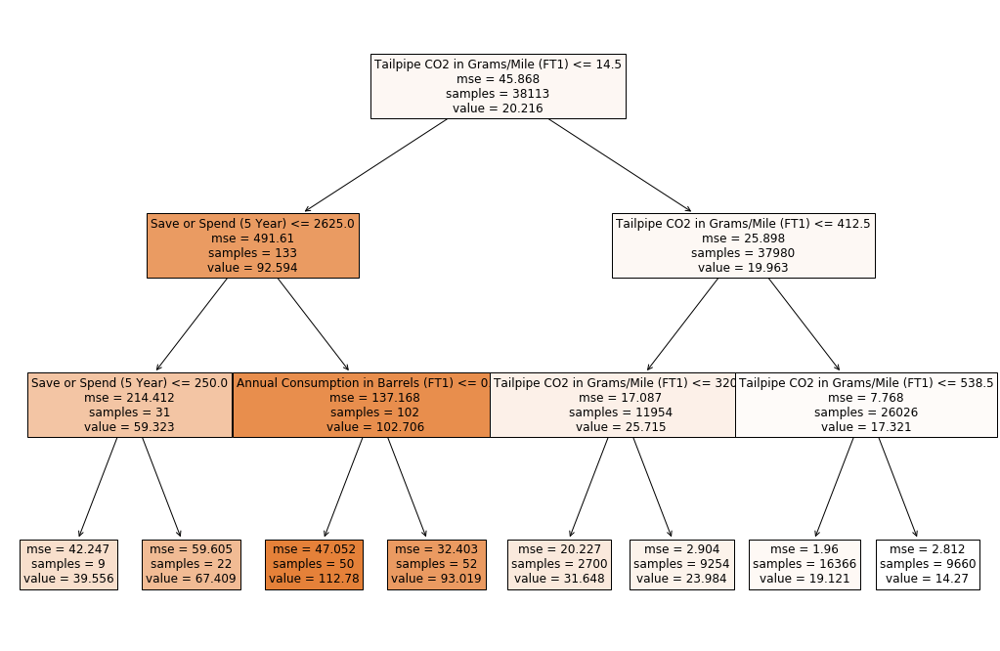

In [616]:
## visualizing a basic tree first
import matplotlib.pyplot as plt

plt.figure(figsize = (18, 12))

plot_tree(pipe[-1], fontsize = 12, feature_names = X.columns, filled = True);

## very small number of samples winding up on the right side -- probably all electric cars...

In [617]:
### splitting in chronological order so about 20% of obs are in the test for years 2012-2017 and
## vaidation set the last 6 years before test set
train = df.loc[df['Year'] < 2006]
val = df.loc[(df['Year'] <2012) & (df['Year'] > 2005)]
test = df.loc[df['Year'] >=2012]


X_train = train.drop('Combined MPG (FT1)', axis = 1)
y_train = train['Combined MPG (FT1)']
X_val = val.drop('Combined MPG (FT1)', axis = 1)
y_val = val['Combined MPG (FT1)']
X_test = test.drop('Combined MPG (FT1)', axis = 1)
y_test = test['Combined MPG (FT1)']

In [618]:
print(X_train.shape), print(y_train.shape),
print(X_val.shape), print(y_val.shape),
print(X_test.shape), print(y_test.shape)

(24035, 38)
(24035,)
(6816, 38)
(6816,)
(7262, 38)
(7262,)


(None, None)

In [619]:
## encode fuel type 1 with one hot encoding since specific fuel types have a lot of impact on MPG score
## trying target encoder for all other categorical variables since there's no natural order for most of them
## starting with Decision Tree Regressor wth max depth 3 and will test other pipelines later
mod = DecisionTreeRegressor(max_depth = 5)
ohe = ce.OneHotEncoder(cols = ['Fuel Type', 'Fuel Type 1'], use_cat_names = True)
te  = ce.TargetEncoder()
pipe = make_pipeline(ohe, te, mod)


In [620]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['Fuel Type', 'Fuel Type 1'],
                               use_cat_names=True)),
                ('targetencoder',
                 TargetEncoder(cols=['Make', 'Model', 'Class', 'Drive',
                                     'Transmission', 'My MPG Data',
                                     'Alternative Fuel/Technology'])),
                ('decisiontreeregressor', DecisionTreeRegressor(max_depth=5))])

In [621]:
pipe.score(X_val, y_val)

0.9838365110148811

In [622]:
## val score seems too high -- likely due to the presence of electric cars

get_feature_importances(pipe, X_train, onehot=True)

## Tailpipe CO2 seems like the only important predictor of MPG, want to remove some of the less relevant features

,Col,Importance
30,Tailpipe CO2 in Grams/Mile (FT1),0.958910
29,Annual Consumption in Barrels (FT1),0.022157
27,Annual Fuel Cost (FT1),0.008268
28,Save or Spend (5 Year),0.005149
11,Fuel Type_Diesel,0.003433
20,Fuel Type 1_Diesel,0.001537
19,Fuel Type 1_Regular Gasoline,0.000546
37,4D Luggage Volume,0.000000
31,GHG Score,0.000000
32,GHG Score (Alt Fuel),0.000000


In [623]:
px.scatter(train, x='Tailpipe CO2 in Grams/Mile (FT1)', y='Combined MPG (FT1)',facet_row='Fuel Type 1', height = 1000)

In [624]:
# going to redo model and remove electric cars. model will predict Combined MPG for conventional cars only.
# model predicting that Electric cars have higher MPG seems unhelpful to the consumer since it is likely obvious

In [625]:
df = df[df["Fuel Type 1"] != "Electricity"]

In [626]:
df[['Fuel Type 1','Fuel Type']].value_counts()

Fuel Type 1        Fuel Type                  
Regular Gasoline   Regular                        25258
Premium Gasoline   Premium                        10133
Regular Gasoline   Gasoline or E85                 1223
Diesel             Diesel                          1014
Premium Gasoline   Premium or E85                   122
Midgrade Gasoline  Midgrade                          77
Natural Gas        CNG                               60
Premium Gasoline   Premium and Electricity           25
Regular Gasoline   Gasoline or natural gas           20
                   Regular Gas and Electricity       20
Premium Gasoline   Premium Gas or Electricity        18
Regular Gasoline   Gasoline or propane                8
                   Regular Gas or Electricity         2
dtype: int64

                                    Col  Importance
18     Tailpipe CO2 in Grams/Mile (FT1)    0.942844
16               Save or Spend (5 Year)    0.037410
17  Annual Consumption in Barrels (FT1)    0.019746
0                            Vehicle ID    0.000000
21                          My MPG Data    0.000000
23                    2D Luggage Volume    0.000000
24                  4D Passenger Volume    0.000000
25                    4D Luggage Volume    0.000000
26           Hatchback Passenger Volume    0.000000
27             Hatchback Luggage Volume    0.000000
28          Alternative Fuel/Technology    0.000000
29    Gasoline/Electricity Blended (CD)    0.000000
30               Hours to Charge (120V)    0.000000
31               Hours to Charge (240V)    0.000000
32            Hours to Charge (AC 240V)    0.000000
33               Composite Combined MPG    0.000000
34                          Range (FT1)    0.000000
35                     City Range (FT1)    0.000000
36          

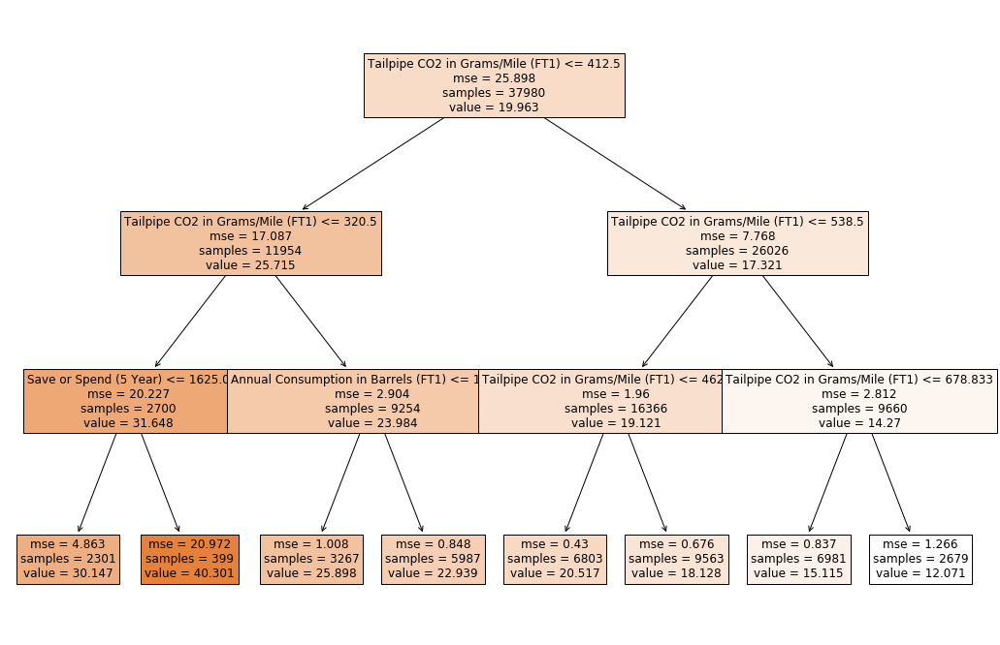

In [627]:
X = df.drop('Combined MPG (FT1)', axis = 1)
y = df['Combined MPG (FT1)']
mod = DecisionTreeRegressor(max_depth = 3)
te  = ce.TargetEncoder()
pipe = make_pipeline(te, mod)
pipe.fit(X, y)
print(get_feature_importances(pipe, X, onehot=False))
## visualizing a basic tree first
import matplotlib.pyplot as plt

plt.figure(figsize = (18, 12))

plot_tree(pipe[-1], fontsize = 12, feature_names = X.columns, filled = True);

In [628]:
### splitting in chronological order so about 20% of obs are in the test for years 2012-2017 and
## vaidation set the last 6 years before test set
train = df.loc[df['Year'] < 2006]
val = df.loc[(df['Year'] <2012) & (df['Year'] > 2005)]
test = df.loc[df['Year'] >=2012]


X_train = train.drop('Combined MPG (FT1)', axis = 1)
y_train = train['Combined MPG (FT1)']
X_val = val.drop('Combined MPG (FT1)', axis = 1)
y_val = val['Combined MPG (FT1)']
X_test = test.drop('Combined MPG (FT1)', axis = 1)
y_test = test['Combined MPG (FT1)']

In [629]:
## now only trying target encoder since the fuel type might be less relevant without electric vehicles
## trying target encoder for all other categorical variables since there's no natural order for most of them
## starting with Decision Tree Regressor wth max depth 3 and will test other pipelines later
mod = DecisionTreeRegressor(max_depth = 3)
ohe = ce.OneHotEncoder()
ore = ce.OrdinalEncoder()
te  = ce.TargetEncoder()
pipe = make_pipeline(te, mod)


In [630]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('targetencoder',
                 TargetEncoder(cols=['Make', 'Model', 'Class', 'Drive',
                                     'Transmission', 'Fuel Type', 'Fuel Type 1',
                                     'My MPG Data',
                                     'Alternative Fuel/Technology'])),
                ('decisiontreeregressor', DecisionTreeRegressor(max_depth=3))])

In [631]:
pipe.score(X_val, y_val)

0.9501601162314189

In [632]:
## might still be overfitting somewhere 
get_feature_importances(pipe, X_train, onehot=False)

,Col,Importance
18,Tailpipe CO2 in Grams/Mile (FT1),0.827663
15,Annual Fuel Cost (FT1),0.172337
0,Vehicle ID,0.000000
20,GHG Score (Alt Fuel),0.000000
22,2D Passenger Volume,0.000000
23,2D Luggage Volume,0.000000
24,4D Passenger Volume,0.000000
25,4D Luggage Volume,0.000000
26,Hatchback Passenger Volume,0.000000
27,Hatchback Luggage Volume,0.000000


In [633]:
## removing some of the features that aren't affecting MPG 
## removing features that might be a product of MPG and may be causing overfitting **not a car expert so I am using my best judgement based on descsriptions on source website
## want to keep car-specific variables (make, model, etc.) because we are interested in predicting MPG for different cars
## imagine consumer interested in purchasing car and what car characteristics most affect MPG

df = df.drop(['Tailpipe CO2 in Grams/Mile (FT1)','Save or Spend (5 Year)','My MPG Data','Annual Fuel Cost (FT1)','Annual Consumption in Barrels (FT1)','Combined Electricity Consumption','Annual Fuel Cost (FT1)','Save or Spend (5 Year)','Composite Combined MPG','City Range (FT1)','num_years'], axis=1)

In [634]:
df.head(2)

,Vehicle ID,Year,Make,Model,Class,Drive,Transmission,Engine Index,Engine Cylinders,Engine Displacement,Fuel Type,Fuel Type 1,Combined MPG (FT1),Combined Gasoline Consumption (CD),Combined Utility Factor,GHG Score,GHG Score (Alt Fuel),2D Passenger Volume,2D Luggage Volume,4D Passenger Volume,4D Luggage Volume,Hatchback Passenger Volume,Hatchback Luggage Volume,Alternative Fuel/Technology,Gasoline/Electricity Blended (CD),Hours to Charge (120V),Hours to Charge (240V),Hours to Charge (AC 240V),Range (FT1),Highway Range (FT1)
0,26587,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,Missing,Manual 5-Speed,9001,6.0,2.5,Regular,Regular Gasoline,20,0.0,0.0,-1,-1,74,7,0,0,0,0,None,False,0,0.0,0.0,0,0.0
1,27705,1984,Alfa Romeo,GT V6 2.5,Minicompact Cars,Missing,Manual 5-Speed,9005,6.0,2.5,Regular,Regular Gasoline,20,0.0,0.0,-1,-1,74,7,0,0,0,0,None,False,0,0.0,0.0,0,0.0


In [635]:
### splitting in chronological order so about 20% of obs are in the test for years 2012-2017 and
## vaidation set the last 6 years before test set
train = df.loc[df['Year'] < 2006]
val = df.loc[(df['Year'] <2012) & (df['Year'] > 2005)]
test = df.loc[df['Year'] >=2012]


X_train = train.drop('Combined MPG (FT1)', axis = 1)
y_train = train['Combined MPG (FT1)']
X_val = val.drop('Combined MPG (FT1)', axis = 1)
y_val = val['Combined MPG (FT1)']
X_test = test.drop('Combined MPG (FT1)', axis = 1)
y_test = test['Combined MPG (FT1)']

In [636]:
mod = DecisionTreeRegressor(max_depth = 3)
ohe = ce.OneHotEncoder()
ore = ce.OrdinalEncoder()
te  = ce.TargetEncoder()

pipe = make_pipeline(te, mod)
pipe.fit(X_train, y_train).score(X_val, y_val)

0.4364773814764361

In [637]:
## removing those features had a really large impact on the val score 
get_feature_importances(pipe, X_train, onehot=False)

,Col,Importance
3,Model,0.972589
8,Engine Cylinders,0.017148
9,Engine Displacement,0.010263
0,Vehicle ID,0.000000
16,2D Passenger Volume,0.000000
27,Range (FT1),0.000000
26,Hours to Charge (AC 240V),0.000000
25,Hours to Charge (240V),0.000000
24,Hours to Charge (120V),0.000000
23,Gasoline/Electricity Blended (CD),0.000000


In [638]:
?ce.OrdinalEncoder

In [639]:
df['Alternative Fuel/Technology'].value_counts()

None              35066
FFV                1345
Diesel              942
Hybrid              484
Plug-in Hybrid       65
CNG                  50
Bifuel (CNG)         20
Bifuel (LPG)          8
Name: Alternative Fuel/Technology, dtype: int64

In [640]:
ohe = ce.OneHotEncoder(cols=['Fuel Type 1'], use_cat_names=True)
ore = ce.OrdinalEncoder(cols=['Make', 'Class', 'Drive',
                                     'Transmission','Alternative Fuel/Technology'])
te = ce.TargetEncoder()
pipe = make_pipeline(ohe, ore, te, mod)

In [641]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['Fuel Type 1'], use_cat_names=True)),
                ('ordinalencoder',
                 OrdinalEncoder(cols=['Make', 'Class', 'Drive', 'Transmission',
                                      'Alternative Fuel/Technology'],
                                mapping=[{'col': 'Make',
                                          'data_type': dtype('O'),
                                          'mapping': Alfa Romeo                              1
AM General                              2
American Motors Corporation             3
Aston Martin                            4
Audi                                    5
Avanti Motor Corporation                6
Bertone                                 7
Bill Do...
Auto(L3)                            15
Automatic 6-Speed                   16
Automatic (S6)                      17
Automatic 7-Speed                   18
Automatic (S7)                      19
NaN                          

In [642]:
pipe.score(X_val, y_val)

0.4364773814764361

In [643]:
##ohe = ce.OneHotEncoder(cols=['Fuel Type'], use_cat_names=True)
oe = ce.OrdinalEncoder()
pipe = make_pipeline(oe, mod)

In [644]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Make', 'Model', 'Class', 'Drive',
                                      'Transmission', 'Fuel Type',
                                      'Fuel Type 1',
                                      'Alternative Fuel/Technology'],
                                mapping=[{'col': 'Make',
                                          'data_type': dtype('O'),
                                          'mapping': Alfa Romeo                              1
AM General                              2
American Motors Corporation             3
Aston Martin                            4
Audi                                    5
Avanti Motor Corporation                6
Bertone                                 7
Bill Dovell Motor Car Company           8
Bitter Gmbh and Co. Kg                  9
B...
Premium or E85             8
NaN                       -2
dtype: int64},
                                         {'col': 'Fuel Type 1',
     

In [645]:
pipe.score(X_val, y_val)  ## little better when use ordinal encoder for everything

0.5970201283639632

In [646]:
get_feature_importances(pipe, X_train, onehot=False)

,Col,Importance
9,Engine Displacement,0.943407
4,Class,0.029215
22,Alternative Fuel/Technology,0.027378
0,Vehicle ID,0.000000
16,2D Passenger Volume,0.000000
27,Range (FT1),0.000000
26,Hours to Charge (AC 240V),0.000000
25,Hours to Charge (240V),0.000000
24,Hours to Charge (120V),0.000000
23,Gasoline/Electricity Blended (CD),0.000000


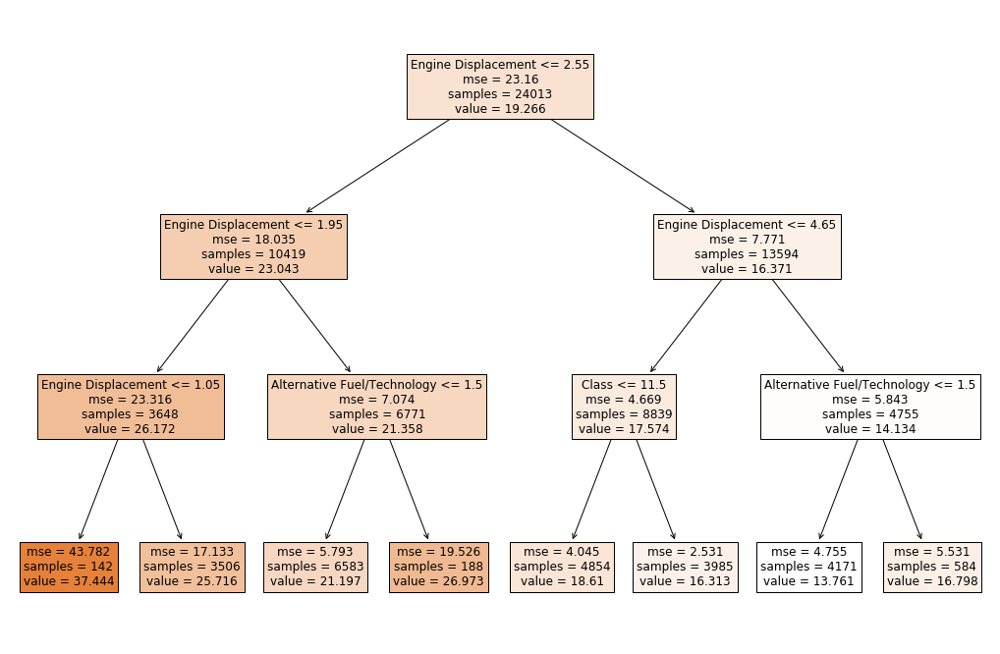

In [647]:
## visualizing  tree 

plt.figure(figsize = (18, 12))

plot_tree(pipe[-1], fontsize = 12, feature_names = X_train.columns, filled = True);


#### Testing different model parameters

In [648]:
def get_val_score(X, y, mod):
    train = df.loc[df['Year'] < 2006]
    val = df.loc[(df['Year'] <2012) & (df['Year'] > 2005)]

    X_train = train.drop('Combined MPG (FT1)', axis = 1)
    y_train = train['Combined MPG (FT1)']

    X_val = val.drop('Combined MPG (FT1)', axis = 1)
    y_val = val['Combined MPG (FT1)']
    
    mod.fit(X_train, y_train)
    return mod.score(X_val, y_val)

In [649]:
max_depth = [3, 4, 5]
max_features = [0.6, 0.8, 1]
min_samples_leaf = [60, 80, 100]
cv_scores = []

for depth in max_depth:
    for feature in max_features:
        for samples in min_samples_leaf:
            print(f"Getting validation score for: depth: {depth}, max_features: {feature}, min_sample_leaf: {samples}")
            pipe[-1].set_params(max_depth = depth, max_features = feature, min_samples_leaf = samples)
            val_score = get_val_score(X_train, y_train, pipe)
            cv_scores.append((val_score, depth, feature, samples))

Getting validation score for: depth: 3, max_features: 0.6, min_sample_leaf: 60
Getting validation score for: depth: 3, max_features: 0.6, min_sample_leaf: 80
Getting validation score for: depth: 3, max_features: 0.6, min_sample_leaf: 100
Getting validation score for: depth: 3, max_features: 0.8, min_sample_leaf: 60
Getting validation score for: depth: 3, max_features: 0.8, min_sample_leaf: 80
Getting validation score for: depth: 3, max_features: 0.8, min_sample_leaf: 100
Getting validation score for: depth: 3, max_features: 1, min_sample_leaf: 60
Getting validation score for: depth: 3, max_features: 1, min_sample_leaf: 80
Getting validation score for: depth: 3, max_features: 1, min_sample_leaf: 100
Getting validation score for: depth: 4, max_features: 0.6, min_sample_leaf: 60
Getting validation score for: depth: 4, max_features: 0.6, min_sample_leaf: 80
Getting validation score for: depth: 4, max_features: 0.6, min_sample_leaf: 100
Getting validation score for: depth: 4, max_features: 

In [650]:
cv_scores

[(0.6093059174988675, 3, 0.6, 60),
 (0.5668462570563547, 3, 0.6, 80),
 (0.5818519178425942, 3, 0.6, 100),
 (0.5875708147481584, 3, 0.8, 60),
 (0.5827623842529719, 3, 0.8, 80),
 (0.6242757300892483, 3, 0.8, 100),
 (0.3055432364796278, 3, 1, 60),
 (-0.05028045778747181, 3, 1, 80),
 (0.07481512779555577, 3, 1, 100),
 (0.5964226847668623, 4, 0.6, 60),
 (0.6584735519423148, 4, 0.6, 80),
 (0.5728889023880581, 4, 0.6, 100),
 (0.6360744228044812, 4, 0.8, 60),
 (0.6622517306011015, 4, 0.8, 80),
 (0.6590883205696036, 4, 0.8, 100),
 (-0.00829402674559132, 4, 1, 60),
 (0.08419122005808066, 4, 1, 80),
 (-0.012209282206188554, 4, 1, 100),
 (0.6278159478567729, 5, 0.6, 60),
 (0.6835891848240002, 5, 0.6, 80),
 (0.6499044621607099, 5, 0.6, 100),
 (0.6746768604284685, 5, 0.8, 60),
 (0.6653402301330049, 5, 0.8, 80),
 (0.6006374033136532, 5, 0.8, 100),
 (0.25598079865404333, 5, 1, 60),
 (0.38345428504204826, 5, 1, 80),
 (0.24935705185025925, 5, 1, 100)]

In [651]:
max(cv_scores)

(0.6835891848240002, 5, 0.6, 80)

In [652]:
pipe[-1].set_params(min_samples_leaf = 60, max_features = 0.8, max_depth = 5)

DecisionTreeRegressor(max_depth=5, max_features=0.8, min_samples_leaf=60)

In [653]:
get_val_score(X_train, y_train, pipe) ## better than last version of pipe

0.657377822873904

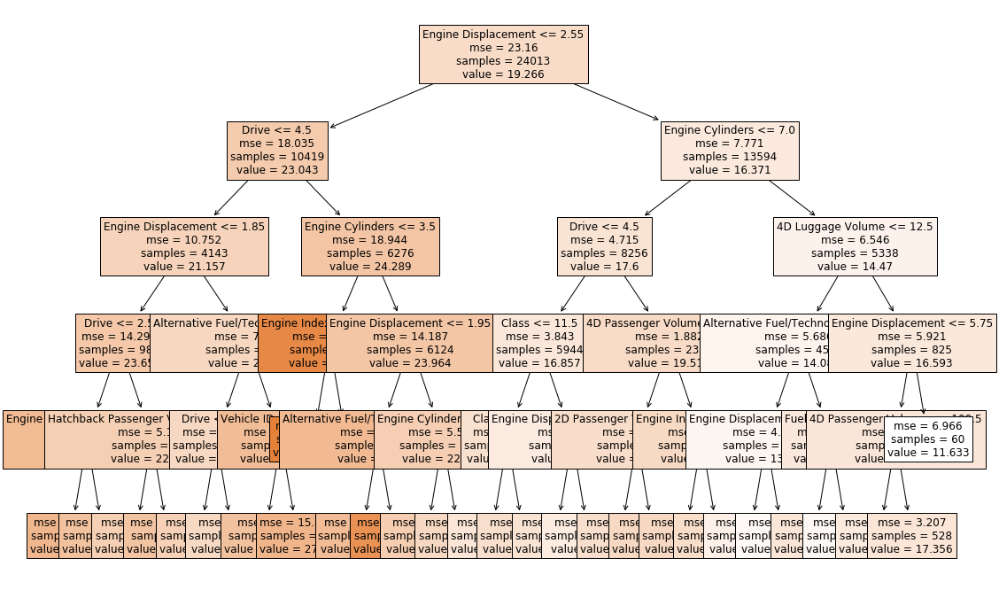

In [654]:
## visualizing  tree 

plt.figure(figsize = (18, 12))

plot_tree(pipe[-1], fontsize = 12, feature_names = X_train.columns, filled = True);


In [655]:
##Engine Displacement most important predictor by a lot but other features have minor impact 
get_feature_importances(pipe, X_train, onehot=False)

,Col,Importance
9,Engine Displacement,0.692350
8,Engine Cylinders,0.137969
5,Drive,0.094533
22,Alternative Fuel/Technology,0.041699
4,Class,0.014759
19,4D Luggage Volume,0.009963
10,Fuel Type,0.003246
7,Engine Index,0.001572
18,4D Passenger Volume,0.001343
20,Hatchback Passenger Volume,0.001108


In [656]:
## trying a Gradient Booster regressor

from sklearn.ensemble import GradientBoostingRegressor
pipe2 = make_pipeline(ce.OrdinalEncoder(),
                     GradientBoostingRegressor(min_samples_leaf = 60, max_features = 0.8, max_depth = 5))

In [657]:
pipe2

Pipeline(steps=[('ordinalencoder', OrdinalEncoder()),
                ('gradientboostingregressor',
                 GradientBoostingRegressor(max_depth=5, max_features=0.8,
                                           min_samples_leaf=60))])

In [658]:
pipe2.fit(X_train, y_train).score(X_val, y_val)

0.7287863704047152

In [659]:
## val score is better with Gradient Boosting than with regular Decision Tree Regressor
## parameter tuning for GB Regressor

max_depth = [4, 5, 6]
max_features = [0.6, 0.8, 1]
min_samples_leaf = [60, 80, 100]
learning_rate = [0.5, 0.1, 0.2]
n_estimators = [50, 100, 200, 300]
cv_scores = []

for depth in max_depth:
    for feature in max_features:
        for samples in min_samples_leaf:
            for rate in learning_rate:
                for estimators in n_estimators:
                    print(f"Getting validation score for: depth: {depth}, max_features: {feature}, min_samples_leaf: {samples}, learning_rate: {rate}, n_estimators: {estimators}")
                    pipe2[-1].set_params(max_depth = depth, max_features = feature, min_samples_leaf = samples, learning_rate = rate, n_estimators = estimators)
                    val_score = get_val_score(X_train, y_train, pipe2)
                    cv_scores.append((val_score, depth, feature, samples, rate, estimators))

Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 50
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 100
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 200
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 300
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.1, n_estimators: 50
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.1, n_estimators: 100
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.1, n_estimators: 200
Getting validation score for: depth: 4, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.1, n_estimators: 300
Getting validation score for: depth: 4, max_featur

Getting validation score for: depth: 4, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 100
Getting validation score for: depth: 4, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 200
Getting validation score for: depth: 4, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 300
Getting validation score for: depth: 4, max_features: 1, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 50
Getting validation score for: depth: 4, max_features: 1, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 100
Getting validation score for: depth: 4, max_features: 1, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 200
Getting validation score for: depth: 4, max_features: 1, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 300
Getting validation score for: depth: 4, max_features: 1, min_samples_leaf: 60, learning_rate: 0.1, n_estimators: 50
Getting validation score for: depth: 4, max_features: 1, 

Getting validation score for: depth: 5, max_features: 0.6, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 300
Getting validation score for: depth: 5, max_features: 0.6, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 50
Getting validation score for: depth: 5, max_features: 0.6, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 100
Getting validation score for: depth: 5, max_features: 0.6, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 200
Getting validation score for: depth: 5, max_features: 0.6, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 300
Getting validation score for: depth: 5, max_features: 0.8, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 50
Getting validation score for: depth: 5, max_features: 0.8, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 100
Getting validation score for: depth: 5, max_features: 0.8, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 200
Getting validation score for: depth: 5, max_f

Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 100
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 200
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 300
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 50
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 100
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 200
Getting validation score for: depth: 5, max_features: 1, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 300
Getting validation score for: depth: 6, max_features: 0.6, min_samples_leaf: 60, learning_rate: 0.5, n_estimators: 50
Getting validation score for: depth: 6, max_features: 0.6

Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.5, n_estimators: 200
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.5, n_estimators: 300
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 50
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 100
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 200
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.1, n_estimators: 300
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 50
Getting validation score for: depth: 6, max_features: 0.8, min_samples_leaf: 100, learning_rate: 0.2, n_estimators: 100
Getting validation score for: depth: 6, ma

In [660]:
max(cv_scores)

(0.8184026449120045, 5, 0.8, 100, 0.5, 200)

In [712]:
## have engines (non-electric cars) changed over time?

In [711]:
X.groupby('Year')['Engine Cylinders'].median()

Year
1984    4.0
1985    4.0
1986    5.0
1987    4.0
1988    6.0
1989    6.0
1990    6.0
1991    6.0
1992    6.0
1993    6.0
1994    6.0
1995    6.0
1996    6.0
1997    6.0
1998    6.0
1999    6.0
2000    6.0
2001    6.0
2002    6.0
2003    6.0
2004    6.0
2005    6.0
2006    6.0
2007    6.0
2008    6.0
2009    6.0
2010    6.0
2011    6.0
2012    6.0
2013    6.0
2014    6.0
2015    6.0
2016    6.0
2017    6.0
Name: Engine Cylinders, dtype: float64

In [707]:
X.groupby('Year')['Engine Displacement'].mean()

Year
1984    3.165071
1985    3.162963
1986    3.183802
1987    3.174018
1988    3.194956
1989    3.209974
1990    3.217440
1991    3.266873
1992    3.276182
1993    3.248582
1994    3.333198
1995    3.471768
1996    3.234799
1997    3.226903
1998    3.213844
1999    3.215148
2000    3.215789
2001    3.210044
2002    3.271223
2003    3.361457
2004    3.393583
2005    3.399485
2006    3.549275
2007    3.628508
2008    3.640894
2009    3.631409
2010    3.513000
2011    3.545031
2012    3.498676
2013    3.382597
2014    3.345960
2015    3.252796
2016    3.132075
2017    3.113648
Name: Engine Displacement, dtype: float64

### Final model 

In [661]:
pipe2[-1].set_params(max_features = 0.6, max_depth = 6, learning_rate=0.5, n_estimators=200)

GradientBoostingRegressor(learning_rate=0.5, max_depth=6, max_features=0.6,
                          min_samples_leaf=100, n_estimators=200)

In [662]:
pipe2

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Make', 'Model', 'Class', 'Drive',
                                      'Transmission', 'Fuel Type',
                                      'Fuel Type 1',
                                      'Alternative Fuel/Technology'],
                                mapping=[{'col': 'Make',
                                          'data_type': dtype('O'),
                                          'mapping': Alfa Romeo                              1
AM General                              2
American Motors Corporation             3
Aston Martin                            4
Audi                                    5
Avanti Motor Corporation                6
Bertone                                 7
Bill Dovell Motor Car Company           8
Bitter Gmbh and Co. Kg                  9
B...
                                          'mapping': Regular Gasoline    1
Diesel              2
Premium Gasoline    3
Natural Gas         4
N

In [663]:
pipe2.fit(X_train, y_train).score(X_val, y_val)

0.8172066196331313

In [664]:
pipe2.score(X_test, y_test)

0.6652081670180983

In [665]:
## scores drop off with val and then test set

In [666]:
get_feature_importances(pipe2, X_train, onehot=False)

,Col,Importance
9,Engine Displacement,0.565486
8,Engine Cylinders,0.123230
5,Drive,0.075754
22,Alternative Fuel/Technology,0.043018
21,Hatchback Luggage Volume,0.035533
4,Class,0.026029
7,Engine Index,0.025912
2,Make,0.019765
6,Transmission,0.017773
10,Fuel Type,0.013710


## Partial Dependence Plotting

In [690]:
# OneHot Columns That we want to look at specific categories impact on MPG
ohe  = ce.OneHotEncoder(cols = ['Class','Drive','Alternative Fuel/Technology'], use_cat_names=True)

# creating a pipe with a target encoder to catch everything el
pipe_pdp = make_pipeline(ohe, ce.OrdinalEncoder())
mod = pipe2[-1]

# transform the data and fit
X_train_pdp = pipe_pdp.fit_transform(X_train, y_train)
mod.fit(X_train_pdp, y_train)

GradientBoostingRegressor(learning_rate=0.5, max_depth=6, max_features=0.6,
                          min_samples_leaf=100, n_estimators=200)

In [693]:
drive_cols = [col for col in X_train_pdp.columns if 'Drive' in col]
class_cols = [col for col in X_train_pdp.columns if 'Class' in col]
altfuel_cols = [col for col in X_train_pdp.columns if 'Alternative Fuel' in col]
print(drive_cols)
print(class_cols)
print(altfuel_cols)

['Drive_Missing', 'Drive_2-Wheel Drive', 'Drive_4-Wheel or All-Wheel Drive', 'Drive_Rear-Wheel Drive', 'Drive_Front-Wheel Drive', 'Drive_4-Wheel Drive']
['Class_Minicompact Cars', 'Class_Two Seaters', 'Class_Special Purpose Vehicle 2WD', 'Class_Special Purpose Vehicle 4WD', 'Class_Subcompact Cars', 'Class_Midsize Cars', 'Class_Midsize Station Wagons', 'Class_Compact Cars', 'Class_Midsize-Large Station Wagons', 'Class_Large Cars', 'Class_Small Station Wagons', 'Class_Standard Pickup Trucks 2WD', 'Class_Vans, Passenger Type', 'Class_Vans, Cargo Type', 'Class_Standard Pickup Trucks 4WD', 'Class_Special Purpose Vehicles', 'Class_Small Pickup Trucks 2WD', 'Class_Small Pickup Trucks 4WD', 'Class_Vans', 'Class_Standard Pickup Trucks', 'Class_Small Pickup Trucks', 'Class_Vans Passenger', 'Class_Standard Pickup Trucks/2wd', 'Class_Special Purpose Vehicles/2wd', 'Class_Special Purpose Vehicles/4wd', 'Class_Sport Utility Vehicle - 4WD', 'Class_Sport Utility Vehicle - 2WD', 'Class_Minivan - 2WD', 

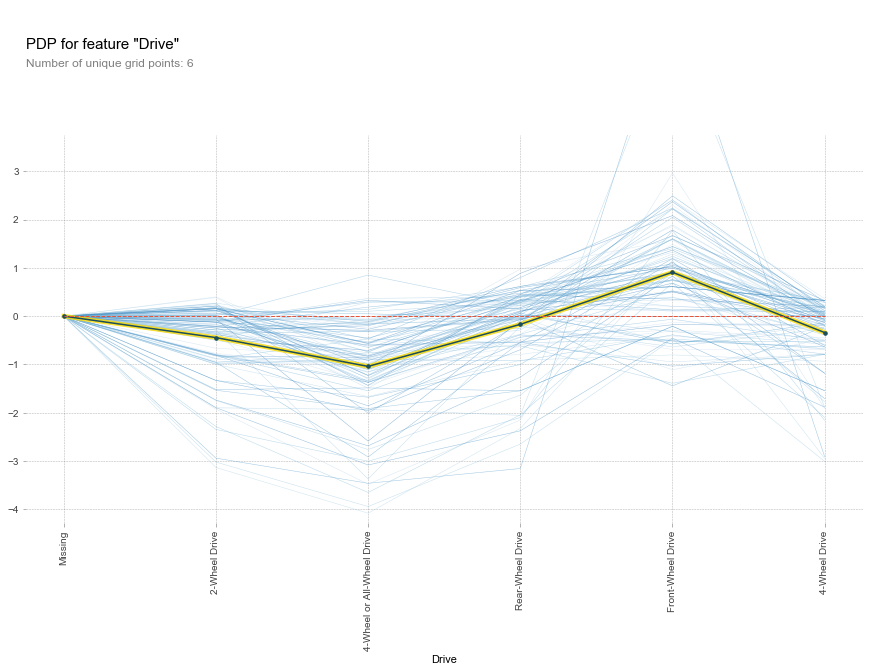

In [699]:
# impact of drive on MPG
pdp_drive = pdp.pdp_isolate(

    model=mod, dataset=X_train_pdp, model_features=X_train_pdp.columns, 
    # this is the list of all the columns for the genre feature
    feature=drive_cols
)

fig, axes = pdp.pdp_plot(pdp_drive, 'Drive', plot_lines=True, frac_to_plot=100)
xtick_labels = [drive.split('_')[1] for drive in drive_cols]
axes['pdp_ax'].set_xticklabels(xtick_labels, rotation='vertical');

#### 4-wheel and all-wheel drive (-) and Front wheel Drive (+) have greatest impact 

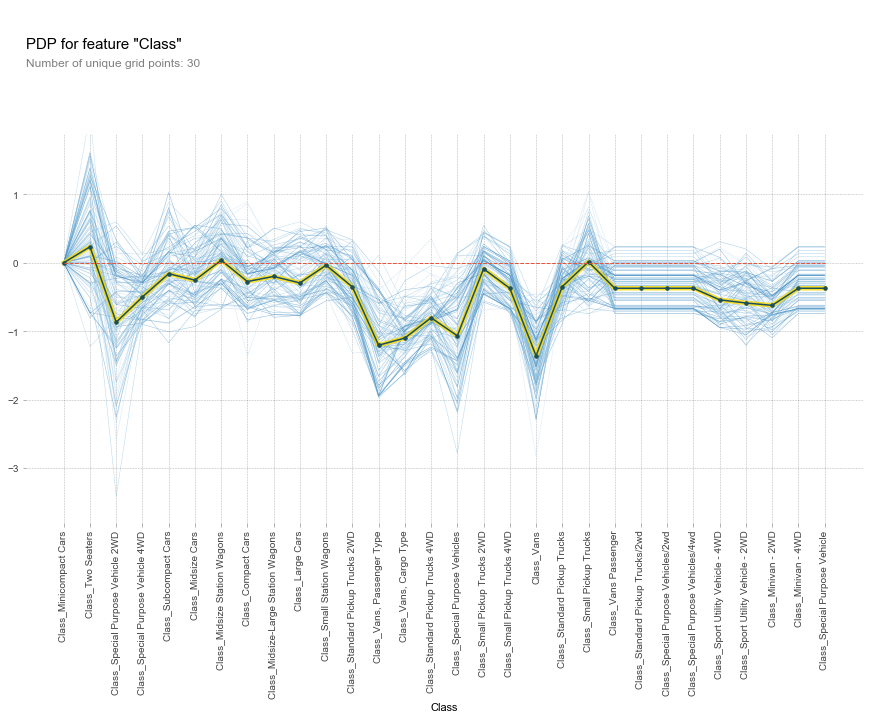

In [700]:
# impact of class 
pdp_class = pdp.pdp_isolate(
    model=mod, dataset=X_train_pdp, model_features=X_train_pdp.columns, 
    feature=class_cols
)

fig, axes = pdp.pdp_plot(pdp_class, 'Class', plot_lines=True, frac_to_plot=100)
xtick_labels = class_cols
axes['pdp_ax'].set_xticklabels(xtick_labels, rotation='vertical');

####  Certain classes of cars have greater impact on Combined MPG -- Special Purpose Vehicles, Vans (-) and slightly positive impact by 2 seaters in particular

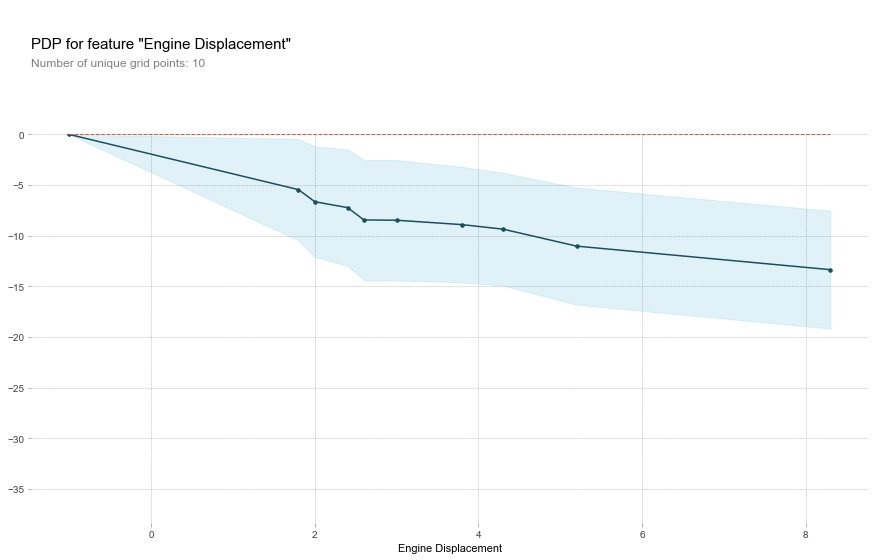

In [702]:
pdp_engined = pdp.pdp_isolate(model = mod, dataset = X_train_pdp, model_features = X_train_pdp.columns,  
    
    feature = 'Engine Displacement'
)

#formatting
fig, axes = pdp.pdp_plot(pdp_engined, 'Engine Displacement')

#### MPG decreases steeply from 0 to about 3 Engine Displacement than levels off a little, but continues to decline

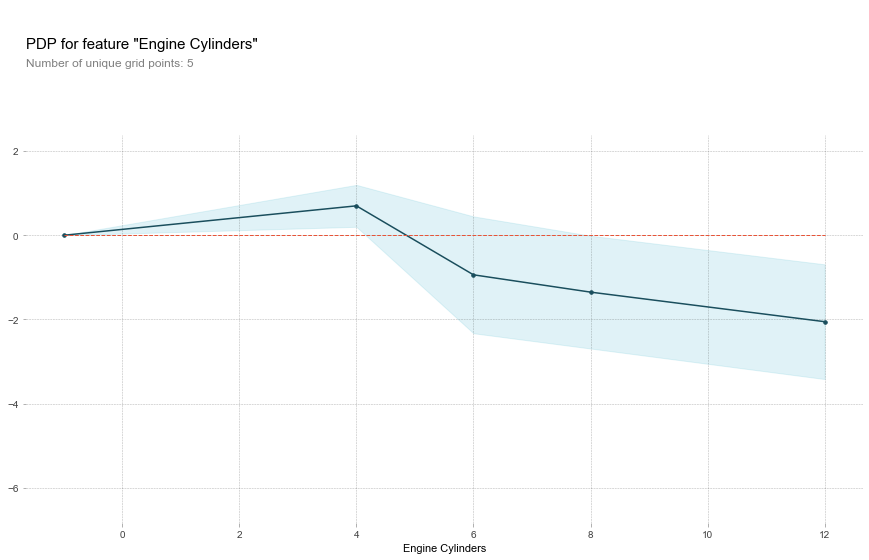

In [703]:
pdp_engined = pdp.pdp_isolate(model = mod, dataset = X_train_pdp, model_features = X_train_pdp.columns,  
    
    feature = 'Engine Cylinders'
)

#formatting
fig, axes = pdp.pdp_plot(pdp_engined, 'Engine Cylinders')

### MPG increases a bit up to 4 engine cylinders, then quickly drops down until 6-8 cylinders.

## Summary

Electric vehicles clearly and obviously have the highest 'fuel economy'; assuming a consumer is not looking for an electric vehicle, the model predicts that Engine Displacement has the largest impact on fuel economy, followed by engine cylinders, and then (a bit behind in importance) the class and drive type of car (which are related). Larger engines and larger vehicles (special purpose, vans) have lower fuel economy, on average, compared to other non-electric cars.  More cylinders affect higher MPG up to a point -- after which, there is a declining impact on MPG.

My issues with this dataset were determining which features to keep or exclude -- many features seem to be an output o of the chosen outcome label of Combined MPG (FT1) and others seem to be closely, if not directly, correlated with each other, so it was a matter of deciding which ones to keep. My lack of car knowledge was also a barrier, but I appreciated that this dataset had a large but not unwieldy number of observations and the column names were easily readable without having to use a lookup table for variable names.

## Pickling for Streamlit

In [715]:
X.columns

Index(['Vehicle ID', 'Year', 'Make', 'Model', 'Class', 'Drive', 'Transmission',
       'Engine Index', 'Engine Cylinders', 'Engine Displacement', 'Fuel Type',
       'Fuel Type 1', 'Combined Electricity Consumption',
       'Combined Gasoline Consumption (CD)', 'Combined Utility Factor',
       'Annual Fuel Cost (FT1)', 'Save or Spend (5 Year)',
       'Annual Consumption in Barrels (FT1)',
       'Tailpipe CO2 in Grams/Mile (FT1)', 'GHG Score', 'GHG Score (Alt Fuel)',
       'My MPG Data', '2D Passenger Volume', '2D Luggage Volume',
       '4D Passenger Volume', '4D Luggage Volume',
       'Hatchback Passenger Volume', 'Hatchback Luggage Volume',
       'Alternative Fuel/Technology', 'Gasoline/Electricity Blended (CD)',
       'Hours to Charge (120V)', 'Hours to Charge (240V)',
       'Hours to Charge (AC 240V)', 'Composite Combined MPG', 'Range (FT1)',
       'City Range (FT1)', 'Highway Range (FT1)', 'num_years'],
      dtype='object')

In [716]:
#making a simplified version for streamlit

In [721]:
X_train_pickle = X_train[['Year','Class','Drive','Engine Cylinders','Engine Displacement','Fuel Type','Alternative Fuel/Technology']]
y_train = df['Combined MPG (FT1)']

In [723]:
pipe2.fit(X_train, y_train)

Pipeline(steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Make', 'Model', 'Class', 'Drive',
                                      'Transmission', 'Fuel Type',
                                      'Fuel Type 1',
                                      'Alternative Fuel/Technology'],
                                mapping=[{'col': 'Make',
                                          'data_type': dtype('O'),
                                          'mapping': Alfa Romeo                              1
AM General                              2
American Motors Corporation             3
Aston Martin                            4
Audi                                    5
Avanti Motor Corporation                6
Bertone                                 7
Bill Dovell Motor Car Company           8
Bitter Gmbh and Co. Kg                  9
B...
                                          'mapping': Regular Gasoline    1
Diesel              2
Premium Gasoline    3
Natural Gas         4
N

In [724]:
# the pickle module allows you to export saved models
import pickle

# rb -- WRITE the file in BYTES
with open('HW4_pipe2.pkl', 'wb') as export:
    # this creates an external version of the file that we can now import later on
    pickle.dump(pipe2, export)

In [725]:
with open('HW4_pipe2.pkl', 'rb') as import_:
    # this will import the pickled object again
    pipe3 = pickle.load(import_)